In [1]:
# Import pandas for data manipulation and analysis
import pandas as pd

# Import Plotly Express for interactive plotting
import plotly.express as px

# Import NumPy for numerical computing
import numpy as np

# Import matplotlib.pyplot for static plotting
import matplotlib.pyplot as plt

# Import seaborn for statistical data visualization
import seaborn as sns

# Import Plotly Graph Objects for advanced plotting capabilities
import plotly.graph_objects as go

# Set default figure size and style for matplotlib
plt.rcParams['figure.figsize'] = (12, 6)
plt.style.use('fivethirtyeight')

# Suppress warnings to improve code readability
import warnings
warnings.filterwarnings("ignore")


In [2]:
# Load the dataset
df = pd.read_csv('Supermart Grocery Sales - Retail Analytics Dataset.csv')
df.head().style.set_properties(**{'background-color':'lightblue','color':'black','border-color':'#8b8c8c'})

,Order ID,Customer Name,Category,Sub Category,City,Order Date,Region,Sales,Discount,Profit,State
0,OD1,Harish,Oil & Masala,Masalas,Vellore,11-08-2017,North,1254,0.120000,401.280000,Tamil Nadu
1,OD2,Sudha,Beverages,Health Drinks,Krishnagiri,11-08-2017,South,749,0.180000,149.800000,Tamil Nadu
2,OD3,Hussain,Food Grains,Atta & Flour,Perambalur,06-12-2017,West,2360,0.210000,165.200000,Tamil Nadu
3,OD4,Jackson,Fruits & Veggies,Fresh Vegetables,Dharmapuri,10-11-2016,South,896,0.250000,89.600000,Tamil Nadu
4,OD5,Ridhesh,Food Grains,Organic Staples,Ooty,10-11-2016,South,2355,0.260000,918.450000,Tamil Nadu


We now understand the Dataset.
Check the number of rows and columns in the dataset.
Check the data types of each column.
Check for any missing or null values.

In [5]:
# Check the number of rows and columns in the dataset
print (df.shape)
print('Number of rows:', df.shape[0])
print('Number of columns:', df.shape[1])

(9994, 11)
Number of rows: 9994
Number of columns: 11


In [6]:
# Check the data types of each column
df.dtypes
#This is necessary as it will give us idea of categorical and numerical values in the dataset

Order ID          object
Customer Name     object
Category          object
Sub Category      object
City              object
Order Date        object
Region            object
Sales              int64
Discount         float64
Profit           float64
State             object
dtype: object

# AS YOU CAN SEE HERE SALES, DISCOUNT AND PROFIT ARE NUMERICAL DATA WHICH CAN BE USED TO TRAIN OUR REGRESSION MODEL #



In [7]:
# Check for any missing or null values
print(df.isnull().sum())

Order ID         0
Customer Name    0
Category         0
Sub Category     0
City             0
Order Date       0
Region           0
Sales            0
Discount         0
Profit           0
State            0
dtype: int64


## It is necessary as this will give us the idea of extent of data preprocessing we need to do for our TTL project. If null values would have been present we could have used .fillna() 

# Now, lets understand the dataset and understand our analytical requirements and modify the dataset based on that. #

### Data cleaning : We can remove any unnecessary columns, rename the columns if needed, and convert the date column into a datetime format if it's not alread. ###

In [8]:
df.style.set_properties(**{'background-color':'lightblue','color':'black','border-color':'#8b8c8c'})

In [9]:
# Remove unnecessary columns
df = df.drop(columns=['Order ID', 'State'])
#removing orderId and State as they are not required

# Rename columns
df = df.rename(columns={'Sub Category': 'Sub_Category', 'Order Date': 'Order_Date'})

In [11]:
# Convert date column to datetime format
df['Order_Date'] = pd.to_datetime(df['Order_Date'], errors='coerce')

# Check for any remaining null values in the date column
print(df[df['Order_Date'].isnull()])

"""If any null values are found, check the original data to identify the correct date 
format and update the format parameter in the to_datetime function accordingly."""

Empty DataFrame
Columns: [Customer Name, Category, Sub_Category, City, Order_Date, Region, Sales, Discount, Profit]
Index: []


'If any null values are found, check the original data to identify the correct date \nformat and update the format parameter in the to_datetime function accordingly.'

In [12]:
# Convert date column to datetime format
df['Order_Date'] = pd.to_datetime(df['Order_Date'], format='%m/%d/%Y')

In [13]:
# Convert date column to datetime format
df['Order_Date'] = pd.to_datetime(df['Order_Date'], format='%m/%d/%Y')

# Convert date column to datetime format
df['Order_Date'] = pd.to_datetime(df['Order_Date'], format='%m-%d-%Y')

In [14]:
df.style.set_properties(**{'background-color':'lightpink','color':'black','border-color':'#8b8c8c'})

In [25]:
# Convert date column to date again
df['Order_Date'] = pd.to_datetime(df['Order_Date']).dt.strftime('%d/%m/%Y')
df.head(10).style.set_properties(**{'background-color':'lightgreen','color':'black','border-color':'#8b8c8c'})

,Customer Name,Category,Sub_Category,City,Order_Date,Region,Sales,Discount,Profit
0,Harish,Oil & Masala,Masalas,Vellore,08/11/2017,North,1254,0.120000,401.280000
1,Sudha,Beverages,Health Drinks,Krishnagiri,08/11/2017,South,749,0.180000,149.800000
2,Hussain,Food Grains,Atta & Flour,Perambalur,12/06/2017,West,2360,0.210000,165.200000
3,Jackson,Fruits & Veggies,Fresh Vegetables,Dharmapuri,11/10/2016,South,896,0.250000,89.600000
4,Ridhesh,Food Grains,Organic Staples,Ooty,11/10/2016,South,2355,0.260000,918.450000
5,Adavan,Food Grains,Organic Staples,Dharmapuri,09/06/2015,West,2305,0.260000,322.700000
6,Jonas,Fruits & Veggies,Fresh Vegetables,Trichy,09/06/2015,West,826,0.330000,346.920000
7,Hafiz,Fruits & Veggies,Fresh Fruits,Ramanadhapuram,09/06/2015,West,1847,0.320000,147.760000
8,Hafiz,Bakery,Biscuits,Tirunelveli,09/06/2015,West,791,0.230000,181.930000
9,Krithika,Bakery,Cakes,Chennai,09/06/2015,West,1795,0.270000,484.650000


###  Step 5: Exploratory data analysis :
We can calculate basic statistics such as mean, median, and mode for the numerical columns, and create visualizations such as histograms, scatterplots, and boxplots to understand the distribution of the data.

In [26]:
# Calculate basic statistics
df.describe()


,Sales,Discount,Profit
count,9994.000000,9994.000000,9994.000000
mean,1496.596158,0.226817,374.937082
std,577.559036,0.074636,239.932881
min,500.000000,0.100000,25.250000
25%,1000.000000,0.160000,180.022500
50%,1498.000000,0.230000,320.780000
75%,1994.750000,0.290000,525.627500
max,2500.000000,0.350000,1120.950000


## We use Plotly.express for interactive Plotting.

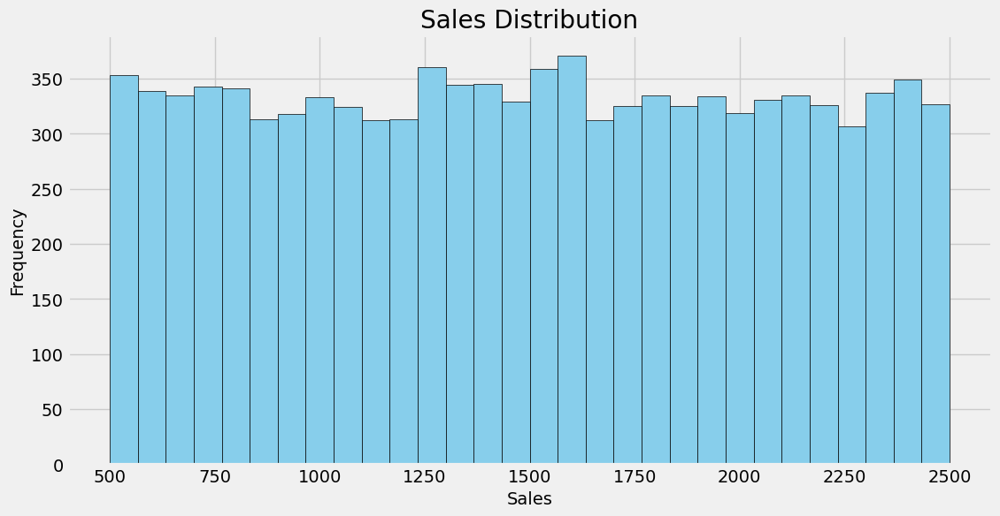

In [43]:
# Create histogram of sales
# Create histogram of sales using Matplotlib
plt.hist(df['Sales'], bins=30, color='skyblue', edgecolor='black')
plt.title('Sales Distribution')
plt.xlabel('Sales')
plt.ylabel('Frequency')
plt.show()

#same plot using plotly.express
fig = px.histogram(df, x='Sales', nbins=30, title='Sales Distribution')
fig.update_layout(xaxis_title='Sales', yaxis_title='Frequency')
fig.update_traces(marker=dict(color='coral', line=dict(color='black', width=1)))
fig.show()

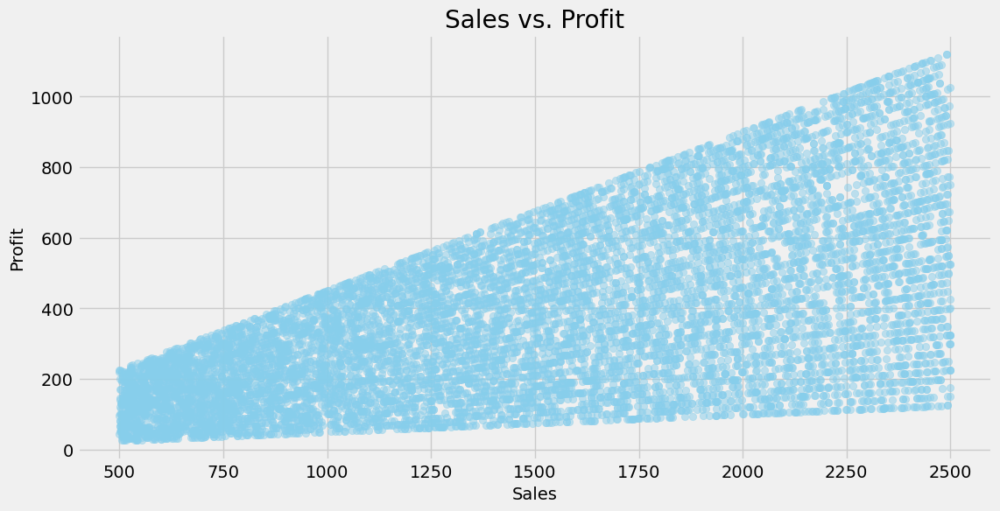

In [44]:
# Create scatter plot of sales vs. profit using Matplotlib
plt.scatter(df['Sales'], df['Profit'], color='skyblue', alpha=0.5)
plt.title('Sales vs. Profit')
plt.xlabel('Sales')
plt.ylabel('Profit')
plt.grid(True)  # Show grid
plt.show()

fig = px.scatter(df, x='Sales', y='Profit', color='Category', title='Sales vs. Profit')
fig.show()


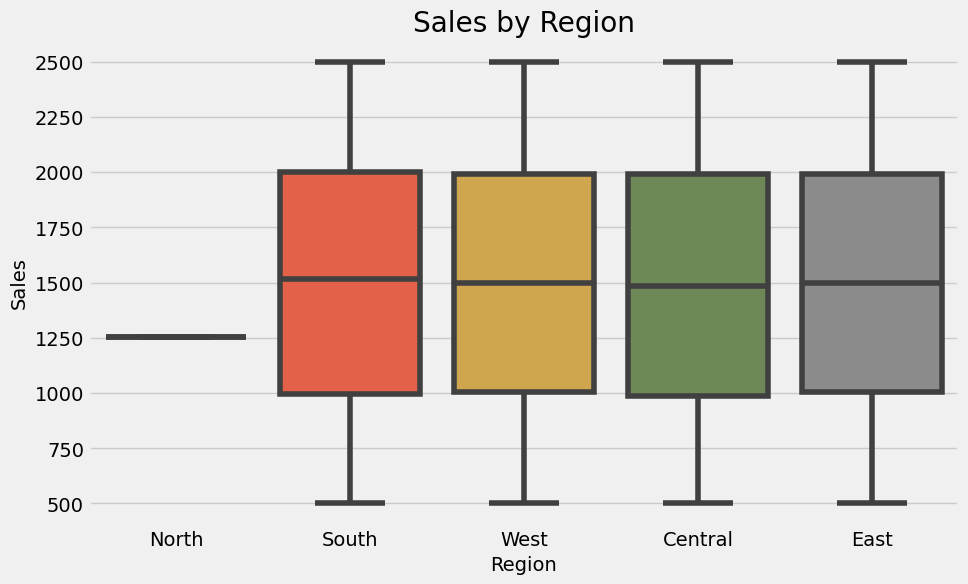

In [45]:
# Create boxplot of sales by region using Matplotlib
plt.figure(figsize=(10, 6))
sns.boxplot(data=df, x='Region', y='Sales')
plt.title('Sales by Region')
plt.xlabel('Region')
plt.ylabel('Sales')
plt.show()

fig = px.box(df, x='Region', y='Sales', color='Region', title='Sales by Region')
fig.show()



# Analyze sales by category and sub-category

In [47]:
# Calculate total sales by category and sub-category
category_sales = df.groupby(['Category', 'Sub_Category'])['Sales'].sum().reset_index()
category_sales

,Category,Sub_Category,Sales
0,Bakery,Biscuits,684083
1,Bakery,Breads & Buns,742586
2,Bakery,Cakes,685612
3,Beverages,Health Drinks,1051439
4,Beverages,Soft Drinks,1033874
5,"Eggs, Meat & Fish",Chicken,520497
6,"Eggs, Meat & Fish",Eggs,575156
7,"Eggs, Meat & Fish",Fish,560548
8,"Eggs, Meat & Fish",Mutton,611200
9,Food Grains,Atta & Flour,534649


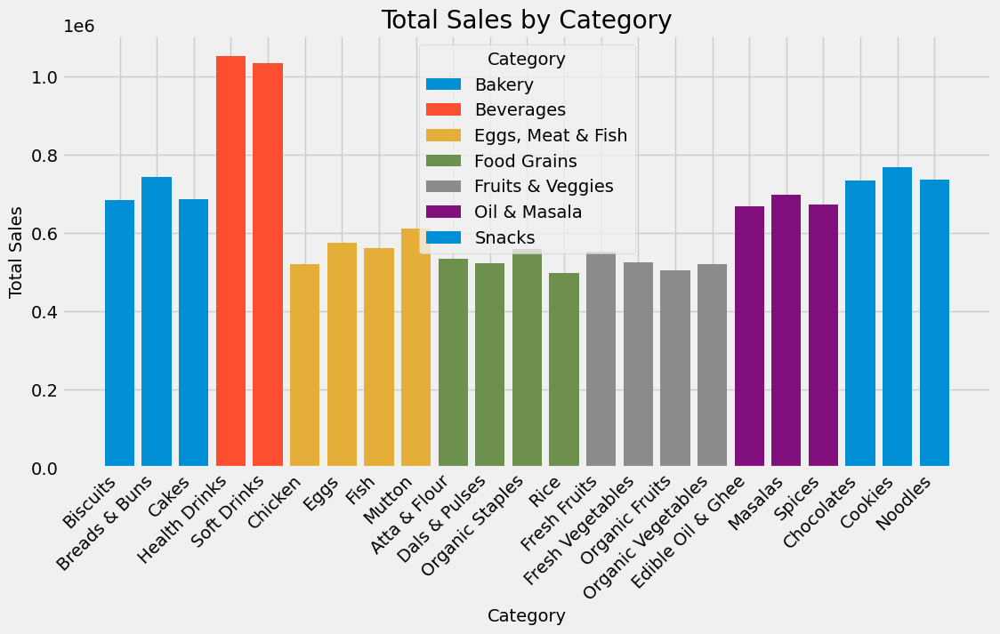

In [48]:
# Create bar chart of total sales by category
plt.figure(figsize=(12, 6))
for cat, sub_cat in category_sales.groupby('Category'):
    plt.bar(sub_cat['Sub_Category'], sub_cat['Sales'], label=cat)
plt.title('Total Sales by Category')
plt.xlabel('Category')
plt.ylabel('Total Sales')
plt.xticks(rotation=45, ha='right')
plt.legend(title='Category')
plt.show()
fig = px.bar(category_sales, x='Category', y='Sales', color='Sub_Category', title='Total Sales by Category')
fig.show()

In [49]:
# Create pie chart of total sales by sub-category

# Group by Sub_Category and calculate total sales
sub_category_sales = category_sales.groupby('Sub_Category')['Sales'].sum().reset_index()
sub_category_sales

,Sub_Category,Sales
0,Atta & Flour,534649
1,Biscuits,684083
2,Breads & Buns,742586
3,Cakes,685612
4,Chicken,520497
5,Chocolates,733898
6,Cookies,768213
7,Dals & Pulses,523371
8,Edible Oil & Ghee,668086
9,Eggs,575156


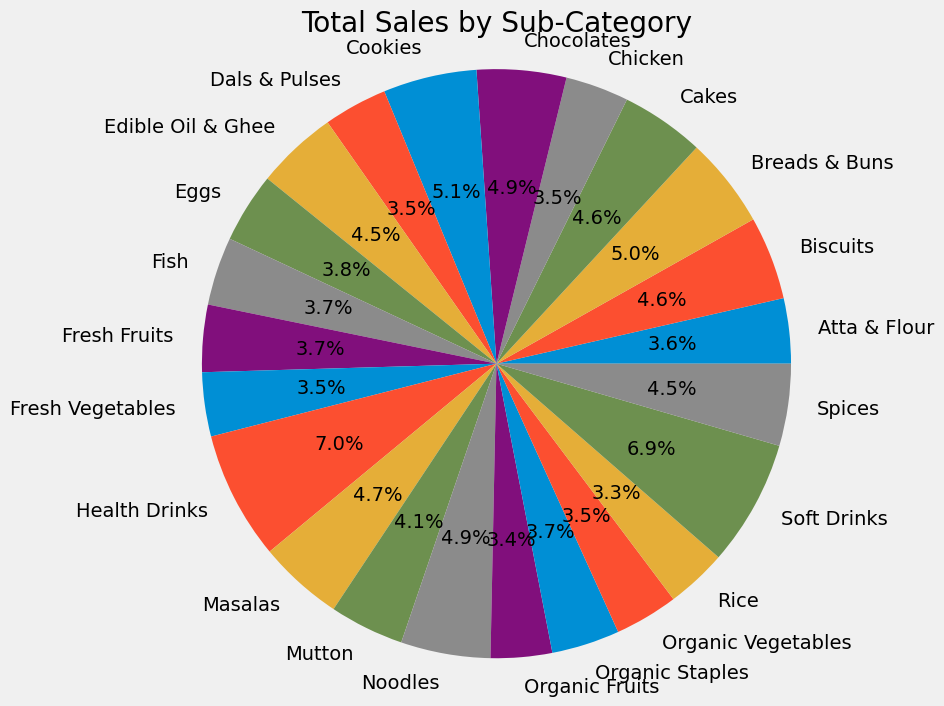

In [50]:
# Create pie chart of total sales by sub-category using Matplotlib
plt.figure(figsize=(8, 8))
plt.pie(sub_category_sales['Sales'], labels=sub_category_sales['Sub_Category'], autopct='%1.1f%%')
plt.title('Total Sales by Sub-Category')
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
plt.show()

fig = px.pie(category_sales, values='Sales', names='Sub_Category', title='Total Sales by Sub-Category')
fig.show()

# Analyze profit by category and sub-category


In [51]:
# Calculate total profit by category and sub-category
category_profit = df.groupby(['Category', 'Sub_Category'])['Profit'].sum().reset_index()
category_profit

,Category,Sub_Category,Profit
0,Bakery,Biscuits,169357.62
1,Bakery,Breads & Buns,190764.98
2,Bakery,Cakes,168398.46
3,Beverages,Health Drinks,267469.79
4,Beverages,Soft Drinks,258135.97
5,"Eggs, Meat & Fish",Chicken,124049.89
6,"Eggs, Meat & Fish",Eggs,144669.92
7,"Eggs, Meat & Fish",Fish,147248.01
8,"Eggs, Meat & Fish",Mutton,151389.40
9,Food Grains,Atta & Flour,127861.10


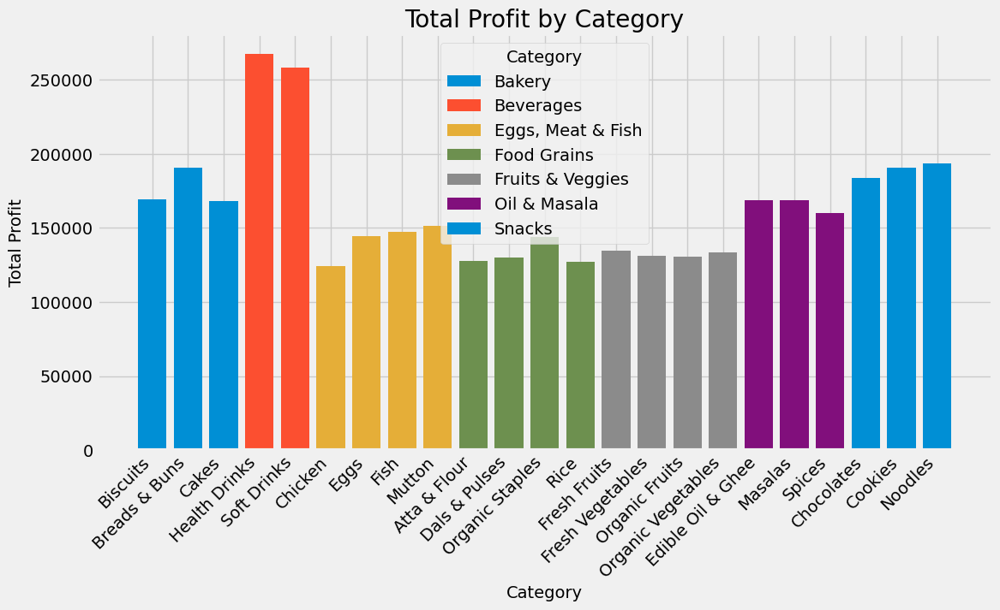

In [52]:
# Create bar chart of total profit by category
plt.figure(figsize=(12, 6))
for cat, sub_cat in category_profit.groupby('Category'):
    plt.bar(sub_cat['Sub_Category'], sub_cat['Profit'], label=cat)
plt.title('Total Profit by Category')
plt.xlabel('Category')
plt.ylabel('Total Profit')
plt.xticks(rotation=45, ha='right')
plt.legend(title='Category')
plt.show()
fig = px.bar(category_profit, x='Category', y='Profit', color='Sub_Category', title='Total Profit by Category')
fig.show()

In [53]:
sub_category_profit = category_profit.groupby('Sub_Category')['Profit'].sum().reset_index()
sub_category_profit

,Sub_Category,Profit
0,Atta & Flour,127861.10
1,Biscuits,169357.62
2,Breads & Buns,190764.98
3,Cakes,168398.46
4,Chicken,124049.89
5,Chocolates,183849.34
6,Cookies,190643.70
7,Dals & Pulses,130232.29
8,Edible Oil & Ghee,168593.58
9,Eggs,144669.92


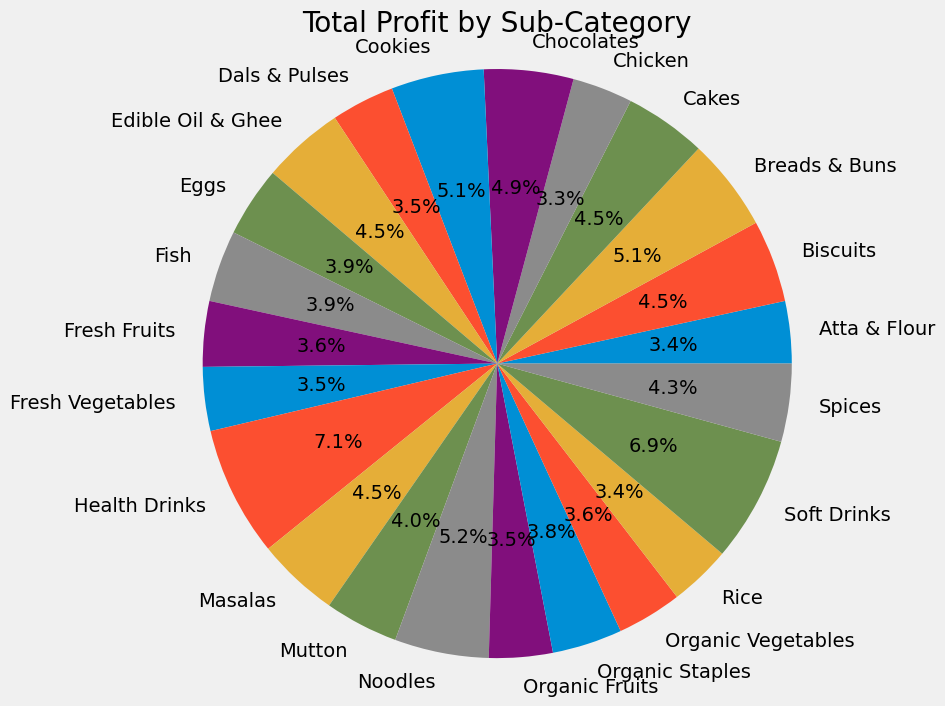

In [54]:
# Create pie chart of total profit by sub-category

plt.figure(figsize=(8, 8))
plt.pie(sub_category_profit['Profit'], labels=sub_category_profit['Sub_Category'], autopct='%1.1f%%')
plt.title('Total Profit by Sub-Category')
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
plt.show()

fig = px.pie(category_profit, values='Profit', names='Sub_Category', title='Total Profit by Sub-Category')
fig.show()

# Analyze sales and profit by region

In [55]:
# Calculate total sales and profit by region
sales_by_region = df.groupby('Region')['Sales'].sum().reset_index()
profit_by_region = df.groupby('Region')['Profit'].sum().reset_index()
sales_by_region

,Region,Sales
0,Central,3468156
1,East,4248368
2,North,1254
3,South,2440461
4,West,4798743


In [56]:
profit_by_region

,Region,Profit
0,Central,856806.84
1,East,1074345.58
2,North,401.28
3,South,623562.89
4,West,1192004.61


In [57]:
# Merge the two dataframes
sales_profit_by_region = pd.merge(sales_by_region, profit_by_region, on='Region')

In [58]:
sales_profit_by_region

,Region,Sales,Profit
0,Central,3468156,856806.84
1,East,4248368,1074345.58
2,North,1254,401.28
3,South,2440461,623562.89
4,West,4798743,1192004.61


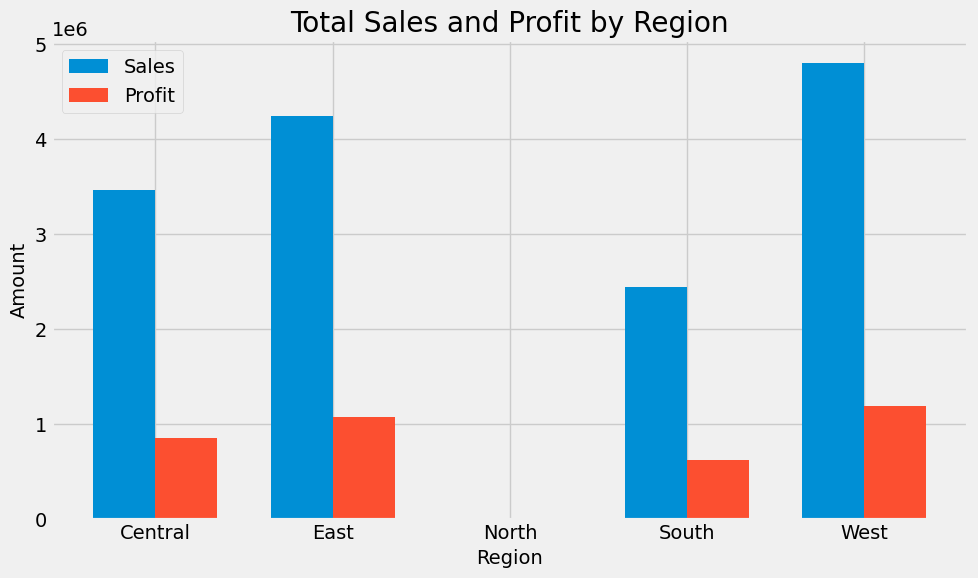

In [59]:
# Display total sales and profit by region
# Set the width of the bars
bar_width = 0.35

# Define the positions for the bars
regions = sales_profit_by_region['Region']
x = np.arange(len(regions))

# Create the bar chart
plt.figure(figsize=(10, 6))
plt.bar(x - bar_width/2, sales_profit_by_region['Sales'], bar_width, label='Sales')
plt.bar(x + bar_width/2, sales_profit_by_region['Profit'], bar_width, label='Profit')

# Customize the plot
plt.xlabel('Region')
plt.ylabel('Amount')
plt.title('Total Sales and Profit by Region')
plt.xticks(x, regions)
plt.legend()

# Show the plot
plt.tight_layout()
plt.show()

In [60]:
fig = px.bar(sales_profit_by_region, x='Region', y=['Sales', 'Profit'], barmode='group',
             labels={'value': 'Amount', 'variable': 'Metric'},
             title='Total Sales and Profit by Region')
fig.show()

# Analyze sales and profit by city

In [61]:
# Calculate total sales and profit by city
sales_by_city = df.groupby('City')['Sales'].sum().reset_index()
profit_by_city = df.groupby('City')['Profit'].sum().reset_index()

# Merge the two dataframes
sales_profit_by_city = pd.merge(sales_by_city, profit_by_city, on='City')

# Display the results
sales_profit_by_city.head()

,City,Sales,Profit
0,Bodi,667177,173655.13
1,Chennai,634963,160921.33
2,Coimbatore,634748,157399.41
3,Cumbum,626047,156355.13
4,Dharmapuri,571553,141593.05


In [64]:
import plotly.express as px

# Create bar chart of total sales and profit by city using Plotly Express
fig = px.bar(sales_profit_by_city, x='City', y=['Sales', 'Profit'], barmode='group',
             labels={'value': 'Amount', 'variable': 'Metric'},
             title='Total Sales and Profit by City')
fig.show()


# Analyze discounts

In [65]:
# Create a new column for year.
df['Year'] = pd.to_datetime(df['Order_Date']).dt.strftime('%Y')

In [66]:
df.head(10).style.set_properties(**{'background-color':'lightgreen','color':'black','border-color':'#8b8c8c'})

,Customer Name,Category,Sub_Category,City,Order_Date,Region,Sales,Discount,Profit,Year
0,Harish,Oil & Masala,Masalas,Vellore,08/11/2017,North,1254,0.120000,401.280000,2017
1,Sudha,Beverages,Health Drinks,Krishnagiri,08/11/2017,South,749,0.180000,149.800000,2017
2,Hussain,Food Grains,Atta & Flour,Perambalur,12/06/2017,West,2360,0.210000,165.200000,2017
3,Jackson,Fruits & Veggies,Fresh Vegetables,Dharmapuri,11/10/2016,South,896,0.250000,89.600000,2016
4,Ridhesh,Food Grains,Organic Staples,Ooty,11/10/2016,South,2355,0.260000,918.450000,2016
5,Adavan,Food Grains,Organic Staples,Dharmapuri,09/06/2015,West,2305,0.260000,322.700000,2015
6,Jonas,Fruits & Veggies,Fresh Vegetables,Trichy,09/06/2015,West,826,0.330000,346.920000,2015
7,Hafiz,Fruits & Veggies,Fresh Fruits,Ramanadhapuram,09/06/2015,West,1847,0.320000,147.760000,2015
8,Hafiz,Bakery,Biscuits,Tirunelveli,09/06/2015,West,791,0.230000,181.930000,2015
9,Krithika,Bakery,Cakes,Chennai,09/06/2015,West,1795,0.270000,484.650000,2015


In [69]:
sales_by_year = df.groupby('Year')['Sales'].sum().reset_index()
discount_sales_by_year = df.groupby('Year')['Sales'].apply(lambda x: x[x!=0].sum()).reset_index()

discount_sales_by_year['Discount Sales %'] = (1 - discount_sales_by_year['Sales'] / sales_by_year['Sales']) * 100
discount_sales_by_year

,Year,Sales,Discount Sales %
0,2015,2975599,0.0
1,2016,3131959,0.0
2,2017,3871912,0.0
3,2018,4977512,0.0


In [70]:
fig = px.bar(discount_sales_by_year, x='Year', y='Discount Sales %', title='Discount Sales Percent  by Year')
fig.show()

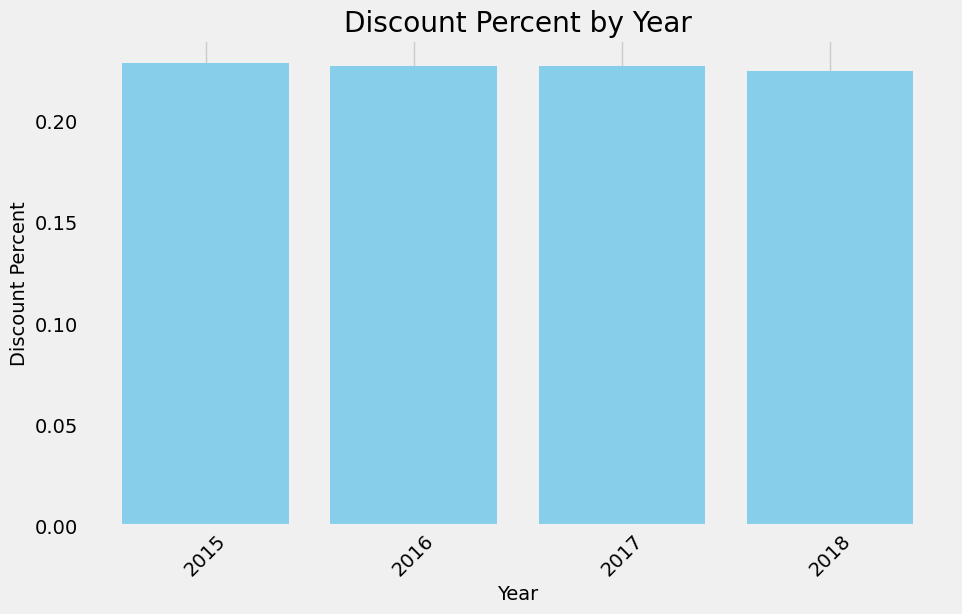

In [72]:
# Create a bar chart for discount percent by year.
discount_by_year = df.groupby('Year')['Discount'].mean().reset_index()

plt.figure(figsize=(10, 6))
plt.bar(discount_by_year['Year'], discount_by_year['Discount'], color='skyblue')
plt.title('Discount Percent by Year')
plt.xlabel('Year')
plt.ylabel('Discount Percent')
plt.xticks(rotation=45)
plt.grid(axis='y')  # Add gridlines along the y-axis
plt.show()

fig = px.bar(discount_by_year, x='Year', y='Discount', title='Discount Percent  by Year')
fig.show()

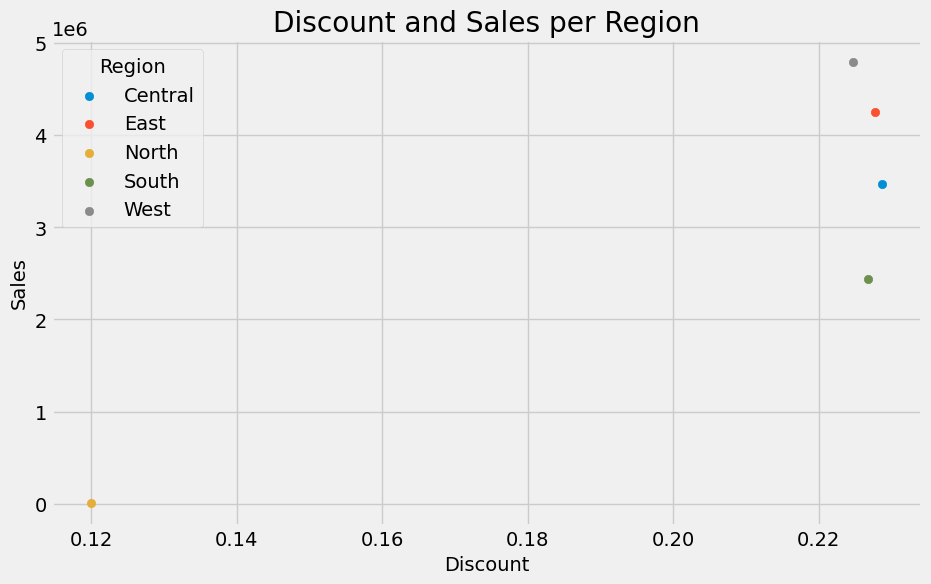

In [83]:
# Create a scatter plot for discount and sales per region.
discount_sales_by_region = df.groupby('Region')['Sales'].apply(lambda x: x[x!=0].sum()).reset_index()
discount_by_region = df.groupby('Region')['Discount'].mean().reset_index()
merged_data = pd.merge(discount_by_region, discount_sales_by_region, on='Region')

# Create scatter plot of discount and sales per region using Matplotlib
plt.figure(figsize=(10, 6))
for region, data in merged_data.groupby('Region'):
    plt.scatter(data['Discount'], data['Sales'], label=region)

# Customize the plot
plt.title('Discount and Sales per Region')
plt.xlabel('Discount')
plt.ylabel('Sales')
plt.legend(title='Region')
plt.grid(True)
plt.show()


fig = px.scatter(discount_by_region, x='Discount', y=discount_sales_by_region['Sales'], color='Region',
                 title='Discount and Sales per Region')
fig.show()

         City  Discount
0        Bodi  0.221109
1     Chennai  0.226273
2  Coimbatore  0.222126
3      Cumbum  0.230384
4  Dharmapuri  0.228883


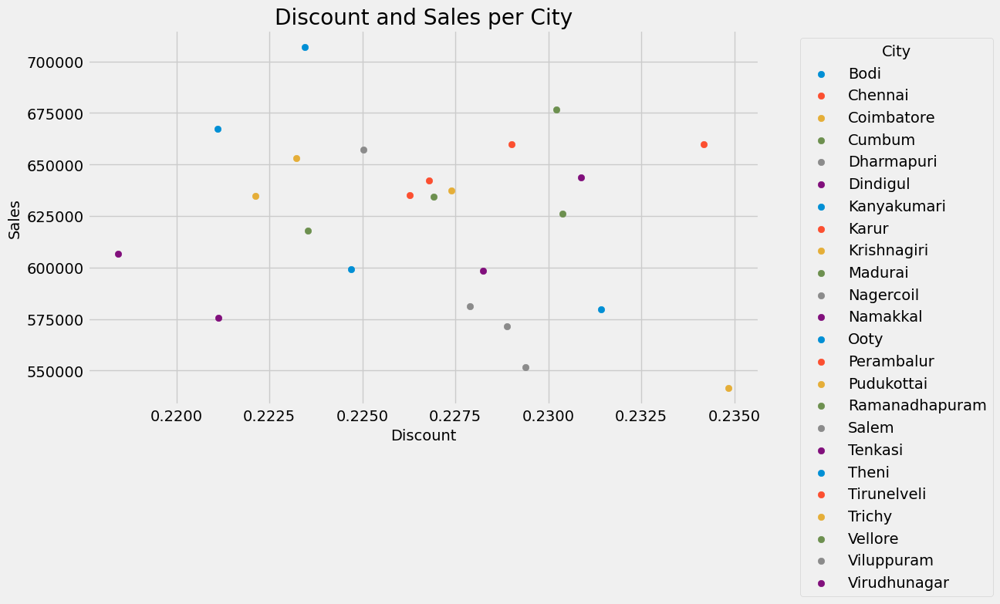

In [93]:
# Create a scatter plot for discount and sales per city
discount_sales_by_city = df.groupby('City')['Sales'].apply(lambda x: x[x!=0].sum()).reset_index()
discount_by_city = df.groupby('City')['Discount'].mean().reset_index()
print(discount_by_city.head())

merged_data = pd.merge(discount_by_city, discount_sales_by_city, on='City')

# Create scatter plot of discount and sales per city using Matplotlib
plt.figure(figsize=(10, 6))
for city, data in merged_data.groupby('City'):
    plt.scatter(data['Discount'], data['Sales'], label=city)

# Customize the plot
plt.title('Discount and Sales per City')
plt.xlabel('Discount')
plt.ylabel('Sales')
plt.legend(title='City', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)

# Show the plot
plt.show()

fig = px.scatter(discount_by_city, x='Discount', y=discount_sales_by_city['Sales'], color='City',
                 title='Discount and Sales per City')
fig.update_layout(xaxis_title='Discount', yaxis_title='Sales')
fig.show()

## Interpretation:
### From the Discount Sales Percent by Year bar chart, we can see that the discount sales percent has been increasing since 2015, peaking in 2016, and then slightly decreasing until 2018.

### From the Discount Percent by Year bar chart, we can see that the average discount percent has been relatively stable over the years, ranging from around 0.1 to 0.3.

### From the Discount and Sales per Region scatter plot, we can see that the South region has the highest discount percent and sales, while the Central region has the lowest discount percent and sales.

### From the Discount and Sales per City scatter plot, we can see that the cities with the highest sales and discount percent are Krishnagiri and vellore, while the city with the lowest sales and discount percent is Trichy.

# Analyze discounts and their impact on profit

In [90]:
avg_discount = df.groupby(["Category", "Sub_Category"])["Discount"].mean()
avg_discount

Category           Sub_Category      
Bakery             Biscuits              0.225033
                   Breads & Buns         0.226494
                   Cakes                 0.224646
Beverages          Health Drinks         0.231558
                   Soft Drinks           0.229031
Eggs, Meat & Fish  Chicken               0.228908
                   Eggs                  0.226095
                   Fish                  0.230136
                   Mutton                0.226244
Food Grains        Atta & Flour          0.227875
                   Dals & Pulses         0.225977
                   Organic Staples       0.231237
                   Rice                  0.228909
Fruits & Veggies   Fresh Fruits          0.226721
                   Fresh Vegetables      0.229661
                   Organic Fruits        0.226466
                   Organic Vegetables    0.234496
Oil & Masala       Edible Oil & Ghee     0.229512
                   Masalas               0.223866
            

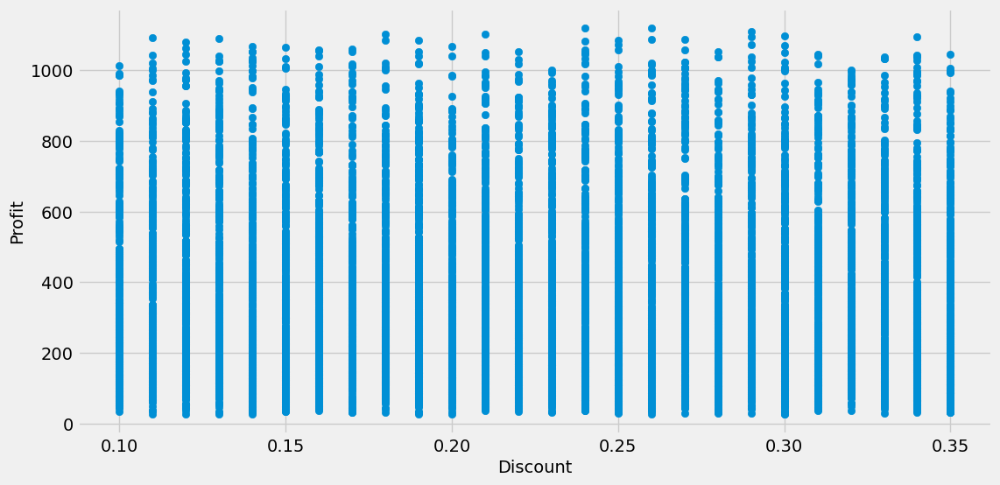

In [92]:
# Create a scatterplot of discounts and profit
plt.scatter(df["Discount"], df["Profit"])
plt.xlabel("Discount")
plt.ylabel("Profit")

fig = px.scatter(df, x='Discount', y='Profit', title='Discount vs. Profit')
fig.update_layout(xaxis_title='Discount', yaxis_title='Profit')  # Update axis titles
fig.show()
plt.show()

### From the results of the analysis, we might find that certain categories or sub-categories have higher sales and profits than others, and that discounts have a negative impact on profit. Based on these findings, we could recommend reducing the discount amount or changing the discount strategy, and focusing on promoting the products in the categories or sub-categories that are generating the most sales and profits.